In [1]:
from lib.notebook_imports import *
import itertools
import scipy.cluster.hierarchy as shc
import prince
from scipy import sparse
import plotly.graph_objects as go

pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 50)
pd.set_option('display.max_colwidth', 50)

%load_ext autoreload
%autoreload 2

shap.initjs()

start_time = datetime.now()


The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.


# READ DATA

In [2]:
from dotenv import load_dotenv
load_dotenv()

True

In [3]:
DATA_PATH = os.environ.get("DATA_PATH")

In [ ]:
data_900 = read_data(DATA_PATH, merge_with_meds=True, merge_with_patient_genes=True)

data_900_df = data_900.input_df.copy()
data_2015_df = read_data_2015(DATA_PATH)

LGB_PARAMS_BASE, N_FOLDS, ALL_MODEL_SUFFIXES, BASE_COLS_1, BASE_COLS_2, ranking_cols = get_consts()


In [5]:
data_900_df['group_mii'] = pd.qcut(data_900_df['day_0_mii'],5)

In [6]:
data_900_df['group_mii'] = data_900_df['group_mii'].astype(str).replace(to_replace = {"(-0.001, 2.0]":"<2","(11.0, 42.0]":"11<"})

In [7]:
data_900_df_mii = data_900_df.loc[pd.notna(data_900_df['mii_group'])].copy()
data_900_df_mii.loc[:,'mii_group'] = pd.Series(data_900_df_mii.loc[:,'mii_group'].astype(str), dtype = "category")
data_900_df_mii.reset_index(drop = True,inplace = True)

In [8]:
DATA_SERIES_900, DATA_SERIES_2015, DATA_SERIES = prepare_data_series(data_900_df, data_2015_df, N_FOLDS)

Original records: 922
Filtered records: 516
Original records: 922
Filtered records: 516
Original records: 12892
Filtered records: 8574
Original records: 12892
Filtered records: 8574
Original records: 12892
Filtered records: 8475


# PREPARE COLUMN SETS

In [ ]:
%%time

GENE_COL_SETS = prepare_gene_column_sets(
    data_900,
    LGB_PARAMS_BASE,
    BASE_COLS_2,
    DATA_SERIES_900,
    ['l1', 'l2', 'log_l2', 'mape']
)


In [7]:
GENE_COL_SETS.BORUTA_GENES_SHORTLIST_WITH_AMH_900

['ESR1_6_152061247_G_A',
 'OTHER_6_22287169_A_T',
 'GDF9_5_132865538_T_C',
 'LHCGR_2_48755729_C_A',
 'LHCGR_2_48725562_C_G',
 'PRLR_5_35069955_T_A',
 'ESR1_6_151944148_-_T']

In [9]:
for key, cols in asdict(GENE_COL_SETS).items():
    print(f'{key.ljust(40, " ")}: {len(cols)}')

ALL_GENES_COLS_900                      : 672
LITERATURE_GENES_COLS_900               : 18
SHAP_IMPORTANT_GENES_COLS_900           : 95
BORUTA_GENES_LONGLIST_WITH_AMH_900      : 63
BORUTA_GENES_LONGLIST_WITHOUT_AMH_900   : 83
SHORTLIST_RANDOM_6_FROM_BORUTA_GENES_LONGLIST_WITH_AMH_900: 6
BORUTA_GENES_SHORTLIST_WITH_AMH_900     : 6
BORUTA_GENES_SHORTLIST_WITHOUT_AMH_900  : 19
SHORTLIST_CONST_900                     : 6
SHORTLIST_CONST_MOTIVATING_900          : 3
SHORTLIST_CONST_DEMOTIVATING_900        : 3
CHROMOSOME_COLS_DICT                    : 10


# Features ranking

In [26]:
ranking = pd.DataFrame(columns=[
    'SHAP',
    'Boruta w AMH',
    'Boruta w/o AMH'])
ranking['wariant'] = np.unique(
    list(itertools.chain.from_iterable([
        GENE_COL_SETS.SHAP_IMPORTANT_GENES_COLS_900,
        GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITH_AMH_900,
        GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITHOUT_AMH_900]))    
    )
ranking.set_index('wariant',drop=True,inplace=True)

In [27]:
ranking['SHAP'] = [GENE_COL_SETS.SHAP_IMPORTANT_GENES_COLS_900.index(i)+1 if np.isin(i,GENE_COL_SETS.SHAP_IMPORTANT_GENES_COLS_900) else len(GENE_COL_SETS.SHAP_IMPORTANT_GENES_COLS_900)+1 for i in ranking.index.to_list()]
ranking['Boruta w AMH'] = [GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITH_AMH_900.index(i)+1 if np.isin(i,GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITH_AMH_900) else len(GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITH_AMH_900)+1 for i in ranking.index.to_list()]
ranking['Boruta w/o AMH'] = [GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITHOUT_AMH_900.index(i)+1 if np.isin(i,GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITHOUT_AMH_900) else len(GENE_COL_SETS.BORUTA_GENES_LONGLIST_WITHOUT_AMH_900)+1 for i in ranking.index.to_list()]

In [28]:
ranking['Score'] = ranking.sum(axis = 1)

In [29]:
ranking.sort_values(by='Score').to_excel(DATA_PATH+'\\ranking_cols.xlsx')

In [9]:
ranking_selected_cols = ranking.sort_values(by='Score').loc[:,'Score'].index[:50].copy()

In [14]:
ranking_selected_cols = ranking.sort_values(by='SHAP').loc[:,'Score'].index[:20].copy()

In [12]:
ranking.sort_values(by='SHAP').head(20)

,SHAP,Boruta w AMH,Boruta w/o AMH,Score
wariant,,,,
LHB_19_49017058_T_C,1,2,1,4
OTHER_19_49015973_T_G,2,6,4,12
AMHR2_12_53424132_T_A,3,7,84,94
PRLR_5_35062516_C_T,4,64,84,152
LHCGR_2_48688732_A_G,5,64,6,75
SOX9_17_72122794_C_T,6,17,84,107
LHCGR_2_48687476_C_G,7,64,7,78
ESR1_6_151702056_G_A,8,64,8,80
FSHB_11_30234748_T_G,9,64,9,82


In [13]:
ranking.sort_values(by='Boruta w/o AMH').head(20)

,SHAP,Boruta w AMH,Boruta w/o AMH,Score
wariant,,,,
LHB_19_49017058_T_C,1,2,1,4
PRLR_5_35072857_T_-,96,64,2,162
FSHR_2_48989145_C_T,96,3,3,102
OTHER_19_49015973_T_G,2,6,4,12
ESR1_6_152098960_G_A,96,15,5,116
LHCGR_2_48688732_A_G,5,64,6,75
LHCGR_2_48687476_C_G,7,64,7,78
ESR1_6_151702056_G_A,8,64,8,80
FSHB_11_30234748_T_G,9,64,9,82


In [55]:
ranking_cols = ranking_selected_cols.to_list()

In [25]:
ranking_cols

['GDF9_5_132865538_T_C',
 'FSHB_11_30234435_A_G',
 'AR_X_67723521_-_ACACAC',
 'GDF9_5_132866205_T_C',
 'ESR1_6_152061176_G_T',
 'PRLR_5_35064922_C_G',
 'ESR1_6_152061247_G_A',
 'LHCGR_2_48729336_C_T',
 'PRL_6_22292324_G_A',
 'PRLR_5_35072278_T_G',
 'FSHR_2_49154446_C_T___5 Prime UTR Variant',
 'ESR2_14_64227477_C_T',
 'PRLR_5_35069955_T_A',
 'PRL_6_22292747_A_T',
 'ESR1_6_152061190_A_G',
 'ESR1_6_152098960_G_A',
 'FSHR_2_48963902_C_T___Missense Variant',
 'AR_X_67723521_-_CACACAC',
 'LHCGR_2_48687476_C_G',
 'PRLR_5_35056614_C_T']

In [236]:
data_900_df_mii.loc[:5,ranking_cols]

,GDF9_5_132865538_T_C,FSHB_11_30234435_A_G,AR_X_67723521_-_ACACAC,GDF9_5_132866205_T_C,ESR1_6_152061176_G_T,PRLR_5_35064922_C_G,ESR1_6_152061247_G_A,LHCGR_2_48729336_C_T,PRL_6_22292324_G_A,PRLR_5_35072278_T_G,FSHR_2_49154446_C_T___5 Prime UTR Variant,ESR2_14_64227477_C_T,PRLR_5_35069955_T_A,PRL_6_22292747_A_T,ESR1_6_152061190_A_G,ESR1_6_152098960_G_A,FSHR_2_48963902_C_T___Missense Variant,AR_X_67723521_-_CACACAC,LHCGR_2_48687476_C_G,PRLR_5_35056614_C_T
0,False,True,False,False,False,False,True,False,False,False,True,True,False,True,False,False,True,False,False,False
1,True,True,False,False,False,False,True,False,False,False,False,False,False,True,False,False,True,True,True,False
2,True,True,False,False,False,False,True,False,False,False,False,False,False,True,False,False,True,True,True,False
3,True,False,False,False,False,False,False,True,False,True,True,False,False,True,False,True,True,True,True,False
4,True,False,False,False,False,False,False,True,False,True,True,False,False,True,False,True,True,True,True,False
5,False,False,True,False,False,False,False,False,True,False,False,True,False,True,False,True,False,True,True,False


In [12]:
columns_to_summarize = ['patient_age',
'day_0_mii',
'cumulus_denuded',
'test_amh_r',
'qual_ds_TSH',
'ds1_3_dawka_dzienna',
'ds4_7_dawka_dzienna'
]

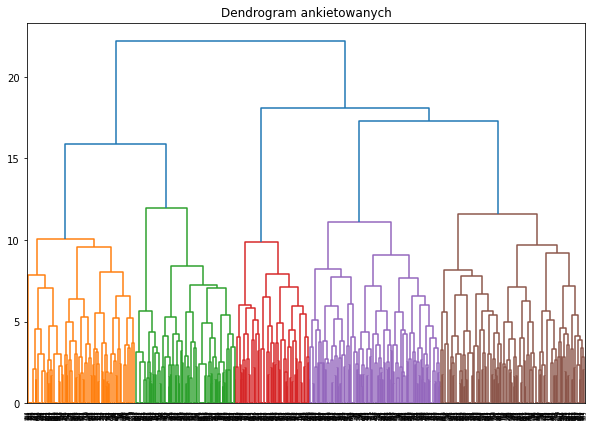

In [11]:
plt.figure(figsize=(10, 7))
plt.title("Dendrogram ankietowanych")
dend = shc.dendrogram(shc.linkage(data_900_df.loc[:,ranking_selected_cols.to_list()], method='ward'))

# Correspondant analysis

In [10]:
ranking_cols = [
    'GDF9_5_132865538_T_C',
    'FSHB_11_30234435_A_G',
    'GDF9_5_132866205_T_C',
    'ESR1_6_152061176_G_T',
    #'PRLR_5_35064922_C_G',
    'ESR1_6_152061247_G_A',
    'LHCGR_2_48729336_C_T',
    'PRL_6_22292324_G_A',
    'PRLR_5_35072278_T_G',
    'FSHR_2_49154446_C_T___5 Prime UTR Variant',
    'ESR2_14_64227477_C_T',
    'PRLR_5_35069955_T_A',
    #'ESR1_6_152061190_A_G',
    'ESR1_6_152098960_G_A',
    'FSHR_2_48963902_C_T___Missense Variant',
    'LHCGR_2_48687476_C_G',
    'BMP15_X_50910775_C_G___5 Prime UTR Variant',
    'PRLR_5_35063190_A_T',
    'BMP15_X_50912016_A_G___Intron Variant',
    "ESR1_6_151807942_T_C"
]

In [41]:
analiza_korespondencji_agg = prepare_CA_data(data_900_df,ranking_cols,'patient_group')

In [42]:
ca = prince.CA(
    n_components=2,
    n_iter=20,
    copy=True,
    check_input=True,
    engine='auto',
    random_state=42
)
analiza_korespondencji_agg.columns.rename('Wariant', inplace=True)
analiza_korespondencji_agg.index.rename('Grupa pacjentek', inplace=True)
ca = ca.fit(analiza_korespondencji_agg.values)

In [35]:
wspolrzedne_indeks = row_coordinates(ca,analiza_korespondencji_agg)
wspolrzedne_indeks.index = analiza_korespondencji_agg.index
wspolrzedne_kolumny = column_coordinates(ca,analiza_korespondencji_agg)
wspolrzedne_kolumny.index = analiza_korespondencji_agg.columns

In [36]:
plot_CA(wspolrzedne_indeks,wspolrzedne_kolumny,ranking_cols,analiza_korespondencji_agg)

In [9]:
ca.explained_inertia_

[0.545566792643197, 0.19799011058150892]

<AxesSubplot:>

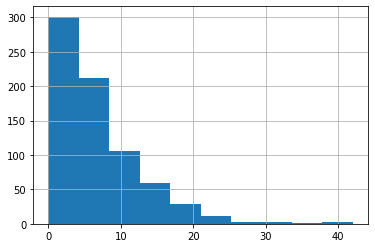

In [54]:
data_900_df['day_0_mii'].hist()

In [28]:
analiza_korespondencji_agg = prepare_CA_data(data_900_df.loc[pd.notna(data_900_df['group_mii'])],ranking_cols,'group_mii')

In [29]:
ca = prince.CA(
    n_components=2,
    n_iter=50,
    copy=True,
    check_input=True,
    engine='auto',
    random_state=1
)
analiza_korespondencji_agg.columns.rename('Wariant', inplace=True)
analiza_korespondencji_agg.index.rename('Grupa pacjentek', inplace=True)
ca = ca.fit(analiza_korespondencji_agg.values)

In [32]:
ranking_cols_short = [
'GDF9 rs11739194:T>C',
'FSHB rs676349:A>G',
'GDF9 rs17166294:T>C',
'ESR1 rs2273206:G>T',
#'PRLR rs56251626:C>G',
'ESR1 rs2207396:G>A',
'LHCGR rs11887058:C>T',
'PRL rs7739889:G>A',
'PRLR rs37364:T>G',
'FSHR rs1394205:C>T',
'ESR2 rs928554:C>T',
'PRLR rs73091143:T>A',
#'ESR1 rs2273207:A>G',
'ESR1 rs2228480:G>A',
'FSHR rs6165:C>T',
'LHCGR rs62137532:C>G',
'BMP15 rs3810682:C>G',
'PRLR rs112461:A>T',
'BMP15 rs3897937:A>G',
'ESR1 rs2077647:T>C'
]

In [41]:
wspolrzedne_indeks = row_coordinates(ca,analiza_korespondencji_agg)
wspolrzedne_indeks.index = analiza_korespondencji_agg.index
wspolrzedne_kolumny = column_coordinates(ca,analiza_korespondencji_agg)
wspolrzedne_kolumny.index = analiza_korespondencji_agg.columns
plot_CA(wspolrzedne_indeks,wspolrzedne_kolumny, ranking_cols_short, analiza_korespondencji_agg)

In [28]:
ca.explained_inertia_

[0.6254230983957658, 0.19770264054693013]

# SOM

In [35]:
from lib.som import assign_neuron,get_characteristic_neurons,create_combinations_columns
import minisom

In [36]:
ranking_cols = [
    'GDF9_5_132865538_T_C',
    'FSHB_11_30234435_A_G',
    'GDF9_5_132866205_T_C',
    'ESR1_6_152061176_G_T',
    'PRLR_5_35064922_C_G',
    'ESR1_6_152061247_G_A',
    'LHCGR_2_48729336_C_T',
    'PRL_6_22292324_G_A',
    'PRLR_5_35072278_T_G',
    'FSHR_2_49154446_C_T___5 Prime UTR Variant',
    'ESR2_14_64227477_C_T',
    'PRLR_5_35069955_T_A',
    'ESR1_6_152061190_A_G',
    'ESR1_6_152098960_G_A',
    'FSHR_2_48963902_C_T___Missense Variant',
    'LHCGR_2_48687476_C_G',
    'BMP15_X_50910775_C_G___5 Prime UTR Variant',
    'PRLR_5_35063190_A_T',
    'BMP15_X_50912016_A_G___Intron Variant',
    "ESR1_6_151807942_T_C"
]

In [37]:
som = minisom.MiniSom(6, 6, len(ranking_cols), sigma=1.5, learning_rate=.7, activation_distance='manhattan',
              topology='hexagonal', neighborhood_function='gaussian', random_seed=42)
som.train(data_900_df_mii.loc[:,ranking_cols].values, 100000, verbose=True)

# data_900_df.loc[:,'group_mii'].astype(str)

 [ 100000 / 100000 ] 100% - 0:00:00 left 
 quantization error: 1.5900554313704274


In [45]:
plot_som(som, data_900_df_mii[ranking_cols], data_900_df_mii.group_mii.astype(str))

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:49: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:62: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:66: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:76: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:100: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:108: RuntimeWarning:

invalid value encountered in true_divide



In [30]:
plot_som(som, data_900_df_mii[ranking_cols], data_900_df_mii.group_mii.astype(str))

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:49: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:62: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:66: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:76: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:100: RuntimeWarning:

invalid value encountered in true_divide

c:\Users\zielinskik.INVICTA-GLOBAL\Desktop\3x1\lib\som.py:108: RuntimeWarning:

invalid value encountered in true_divide



In [238]:
np.isin(
    [
        "GDF9_5_132865538_T_C",
        "GDF9_5_132866205_T_C",
        "LHCGR_2_48729336_C_T",
        "FSHB_11_30234435_A_G",
        "ESR1_6_152061190_A_G",
        "ESR2_14_64227477_C_T",
    ],
    data_900_df_mii.loc[
        som.win_map(data_900_df_mii.loc[:, ranking_cols].values, True)[(2, 1)],
        ranking_cols,
    ]
    .mean(axis=0)
    .sort_values(ascending=False)
    .argsort()[:11]
    .index.values,
)

array([ True,  True,  True,  True,  True,  True])

In [225]:
data_900_df_mii.loc[
    som.win_map(data_900_df_mii.loc[:,ranking_cols].values,True)[(2,1)],
ranking_cols
].sum(axis = 0).sort_values(ascending = False).argsort()[:20].index.values

array(['GDF9_5_132865538_T_C', 'ESR2_14_64227477_C_T',
       'ESR1_6_151807942_T_C', 'GDF9_5_132866205_T_C',
       'FSHB_11_30234435_A_G', 'ESR1_6_152061247_G_A',
       'LHCGR_2_48687476_C_G', 'ESR1_6_152061176_G_T',
       'FSHR_2_48963902_C_T___Missense Variant', 'LHCGR_2_48729336_C_T',
       'ESR1_6_152061190_A_G', 'PRLR_5_35069955_T_A',
       'FSHR_2_49154446_C_T___5 Prime UTR Variant',
       'ESR1_6_152098960_G_A', 'PRLR_5_35072278_T_G',
       'PRL_6_22292324_G_A', 'PRLR_5_35064922_C_G',
       'BMP15_X_50910775_C_G___5 Prime UTR Variant',
       'PRLR_5_35063190_A_T', 'BMP15_X_50912016_A_G___Intron Variant'],
      dtype=object)

In [234]:
data_900_df_mii.loc[
    som.win_map(data_900_df_mii.loc[:,ranking_cols].values,True)[(2,1)],
ranking_cols
].sum(axis = 0).sort_values(ascending = False)[:20]

GDF9_5_132865538_T_C                          39
ESR2_14_64227477_C_T                          38
ESR1_6_151807942_T_C                          36
GDF9_5_132866205_T_C                          30
FSHB_11_30234435_A_G                          24
ESR1_6_152061247_G_A                          23
LHCGR_2_48687476_C_G                          23
ESR1_6_152061176_G_T                          18
FSHR_2_48963902_C_T___Missense Variant        18
LHCGR_2_48729336_C_T                          16
ESR1_6_152061190_A_G                          15
PRLR_5_35069955_T_A                           12
FSHR_2_49154446_C_T___5 Prime UTR Variant      7
ESR1_6_152098960_G_A                           6
PRLR_5_35072278_T_G                            5
PRL_6_22292324_G_A                             4
PRLR_5_35064922_C_G                            2
BMP15_X_50910775_C_G___5 Prime UTR Variant     2
PRLR_5_35063190_A_T                            2
BMP15_X_50912016_A_G___Intron Variant          0
dtype: int64

In [241]:
(data_900_df_mii.loc[
    som.win_map(data_900_df_mii.loc[:,ranking_cols].values,True)[(2,1)],
ranking_cols
].sum(axis = 0)/data_900_df_mii[ranking_cols].sum(axis=0)).sort_values(ascending = False)

PRLR_5_35069955_T_A                           0.179104
GDF9_5_132866205_T_C                          0.166667
ESR1_6_152061190_A_G                          0.166667
ESR1_6_152061176_G_T                          0.133333
GDF9_5_132865538_T_C                          0.120000
LHCGR_2_48687476_C_G                          0.086142
ESR1_6_152061247_G_A                          0.082437
ESR2_14_64227477_C_T                          0.071295
ESR1_6_151807942_T_C                          0.066421
FSHB_11_30234435_A_G                          0.064690
LHCGR_2_48729336_C_T                          0.050157
FSHR_2_48963902_C_T___Missense Variant        0.042959
PRLR_5_35064922_C_G                           0.041667
PRLR_5_35072278_T_G                           0.040323
FSHR_2_49154446_C_T___5 Prime UTR Variant     0.032864
ESR1_6_152098960_G_A                          0.029268
PRL_6_22292324_G_A                            0.014388
PRLR_5_35063190_A_T                           0.011696
BMP15_X_50

In [243]:
np.isin(
    [
        "GDF9_5_132865538_T_C",
        "GDF9_5_132866205_T_C",
        "LHCGR_2_48729336_C_T",
        "FSHB_11_30234435_A_G",
        "ESR1_6_152061190_A_G",
        "ESR2_14_64227477_C_T",
    ],
    (data_900_df_mii.loc[
    som.win_map(data_900_df_mii.loc[:,ranking_cols].values,True)[(2,1)],
    ranking_cols
    ].sum(axis = 0)/data_900_df_mii[ranking_cols].sum(axis=0)).sort_values(ascending = False)[:11]
    .index.values,
)

array([ True,  True,  True,  True,  True,  True])

In [250]:
data_900_df_mii.loc[
    som.win_map(data_900_df_mii.loc[:, ranking_cols].values, True)[(2, 1)],
    ranking_cols,
].mean(axis=0).sort_values(ascending=False).argsort()[:11].index.values[
    np.isin(
        data_900_df_mii.loc[
            som.win_map(data_900_df_mii.loc[:, ranking_cols].values, True)[(2, 1)],
            ranking_cols,
        ]
        .mean(axis=0)
        .sort_values(ascending=False)
        .argsort()[:11]
        .index.values,
        (
            data_900_df_mii.loc[
                som.win_map(data_900_df_mii.loc[:, ranking_cols].values, True)[(2, 1)],
                ranking_cols,
            ].sum(axis=0)
            / data_900_df_mii[ranking_cols].sum(axis=0)
        )
        .sort_values(ascending=False)[:11]
        .index.values,
    )
]

array(['GDF9_5_132865538_T_C', 'ESR2_14_64227477_C_T',
       'ESR1_6_151807942_T_C', 'GDF9_5_132866205_T_C',
       'FSHB_11_30234435_A_G', 'ESR1_6_152061247_G_A',
       'LHCGR_2_48687476_C_G', 'ESR1_6_152061176_G_T',
       'LHCGR_2_48729336_C_T', 'ESR1_6_152061190_A_G'], dtype=object)

In [239]:
data_900_df_mii[[
        "GDF9_5_132865538_T_C",
        "GDF9_5_132866205_T_C",
        "LHCGR_2_48729336_C_T",
        "FSHB_11_30234435_A_G",
        "ESR1_6_152061190_A_G",
        "ESR2_14_64227477_C_T",
    ]].mean()

GDF9_5_132865538_T_C    0.447043
GDF9_5_132866205_T_C    0.247593
LHCGR_2_48729336_C_T    0.438790
FSHB_11_30234435_A_G    0.510316
ESR1_6_152061190_A_G    0.123796
ESR2_14_64227477_C_T    0.733150
dtype: float64

In [157]:
data_som_assigned = assign_neuron(data_900_df_mii, data_900_df_mii[ranking_cols], som)

In [158]:
data_som_assigned, path = get_characteristic_neurons(
    data_som_assigned,
    ranking_cols,
    min_freq=0.2,
    min_obs=10,
    separate=True,
    target_col="mii_group",
)

In [159]:
path

['if (BMP15_X_50910775_C_G___5 Prime UTR Variant <= 0.5) and (PRLR_5_35072278_T_G <= 0.5) and (ESR2_14_64227477_C_T > 0.5) and (GDF9_5_132865538_T_C <= 0.5) and (ESR1_6_152061247_G_A <= 0.5) and (ESR1_6_152061176_G_T <= 0.5) and (FSHR_2_49154446_C_T___5 Prime UTR Variant <= 0.5) and (PRLR_5_35069955_T_A <= 0.5) and (ESR1_6_151807942_T_C > 0.5) and (LHCGR_2_48729336_C_T <= 0.5) then class: (3, 5) (proba: 100.0%) | based on 42 samples',
 'if (BMP15_X_50910775_C_G___5 Prime UTR Variant > 0.5) and (ESR1_6_152061190_A_G <= 0.5) and (ESR1_6_152098960_G_A > 0.5) and (PRLR_5_35072278_T_G <= 0.5) and (FSHR_2_48963902_C_T___Missense Variant > 0.5) and (ESR1_6_152061176_G_T <= 0.5) and (PRL_6_22292324_G_A <= 0.5) then class: (0, 0) (proba: 100.0%) | based on 35 samples',
 'if (BMP15_X_50910775_C_G___5 Prime UTR Variant <= 0.5) and (PRLR_5_35072278_T_G > 0.5) and (GDF9_5_132865538_T_C <= 0.5) and (FSHR_2_48963902_C_T___Missense Variant > 0.5) and (FSHB_11_30234435_A_G > 0.5) then class: (3, 0) (pr

# Impact on the model's RMSE

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1y

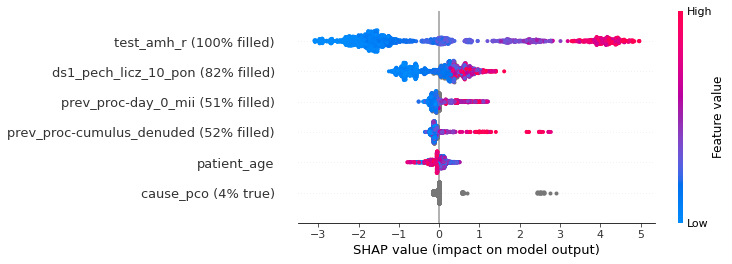

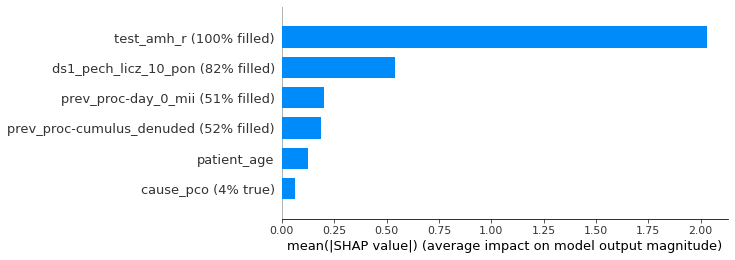

In [70]:
FIRST_VISIT_COLS = [
    "test_amh_r",
    "patient_age",
    "ds1_pech_licz_10_pon",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
]
FIRST_VISIT_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    FIRST_VISIT_COLS,
    model_suffixes_filter=['l2'])
FIRST_VISIT_RESULTS.print_errors(
    [FIRST_VISIT_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    FIRST_VISIT_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

In [34]:
data_900_df.loc[:,wspolrzedne_kolumny.index[
    np.linalg.norm(wspolrzedne_kolumny.values - wspolrzedne_indeks.loc[0,:].values,axis=1).argsort()[:5]
].values].sum(axis = 1)[:8]

8      3
261    4
260    4
198    2
197    2
dtype: int64

In [21]:
DATA_SERIES_900['900_day_0_mii'].input_df['gene_variants'] = data_900_df.loc[:,wspolrzedne_kolumny.index[
    np.linalg.norm(wspolrzedne_kolumny.values - wspolrzedne_indeks.loc[0,:].values,axis=1).argsort()[:8]
].values].sum(axis = 1)

In [22]:
DATA_SERIES_900['900_cumulus_denuded'].input_df['gene_variants'] = data_900_df.loc[:,wspolrzedne_kolumny.index[
    np.linalg.norm(wspolrzedne_kolumny.values - wspolrzedne_indeks.loc[0,:].values,axis=1).argsort()[:8]
].values].sum(axis = 1)

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1y

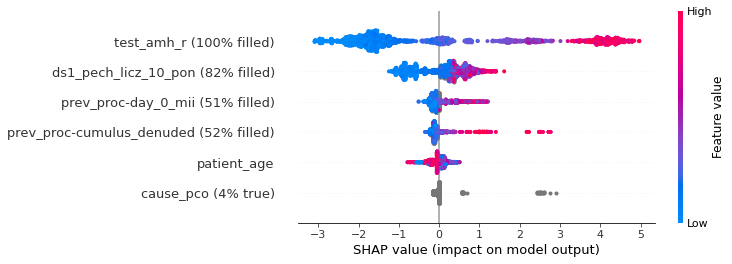

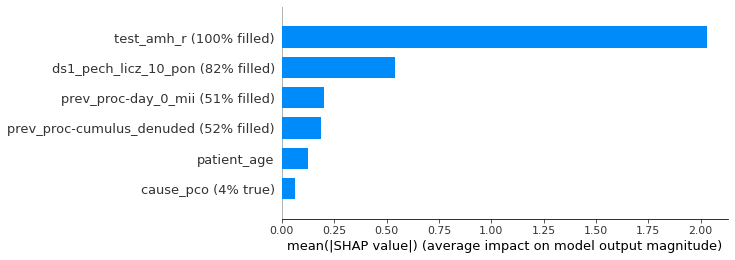

In [14]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco"
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

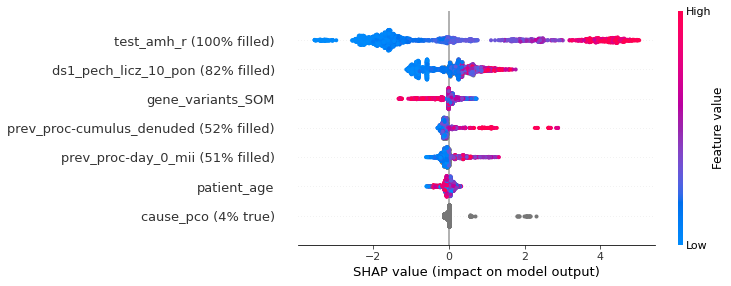

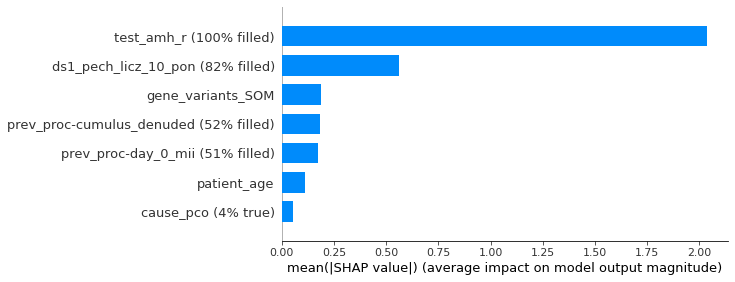

In [6]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    "gene_variants_SOM"
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

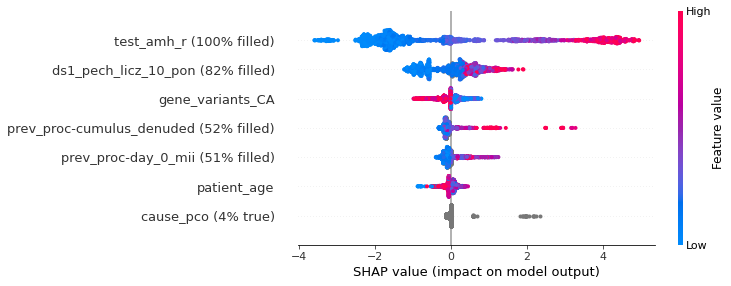

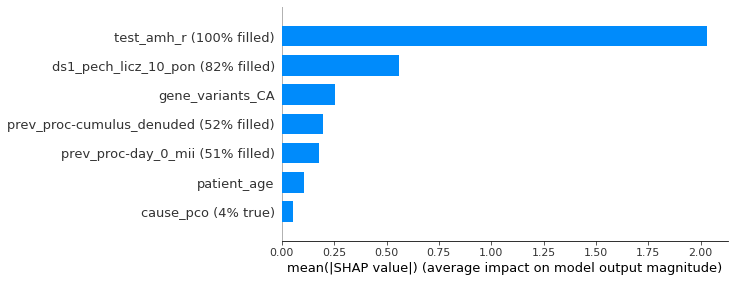

In [5]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    "gene_variants_CA"
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1y

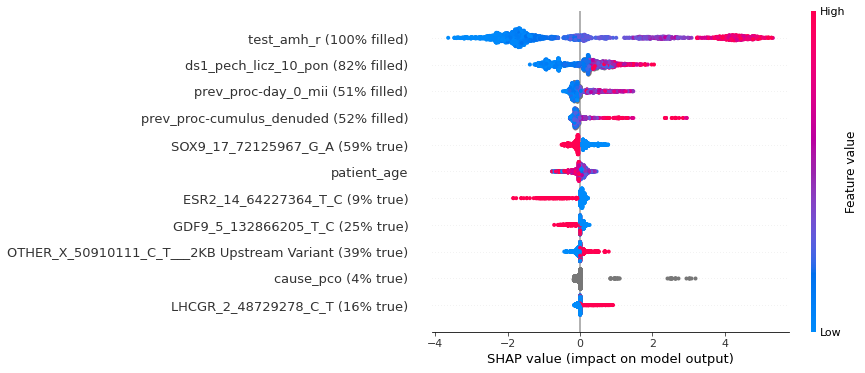

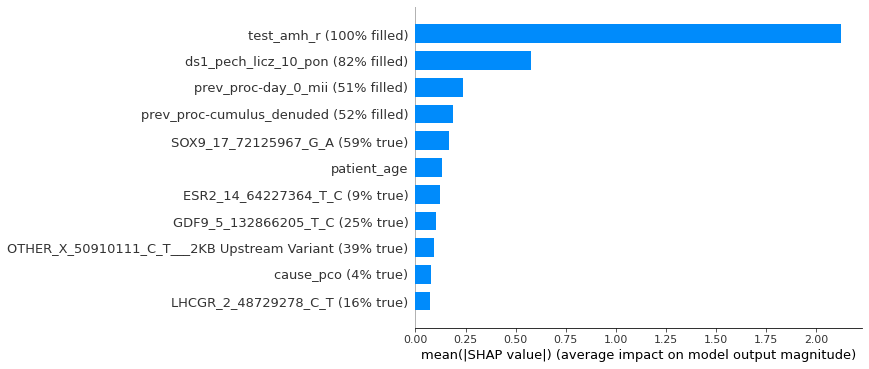

In [15]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    "ESR2_14_64227364_T_C",
    "OTHER_X_50910111_C_T___2KB Upstream Variant",
    "SOX9_17_72125967_G_A",
    "GDF9_5_132866205_T_C",
    "LHCGR_2_48729278_C_T"
]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1y

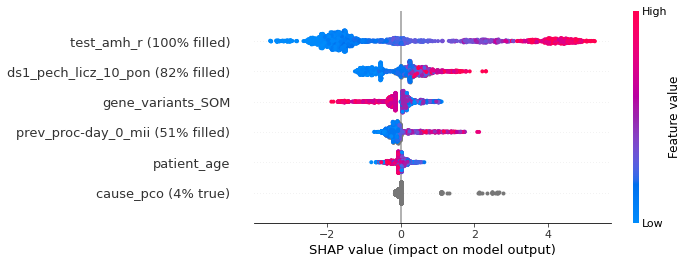

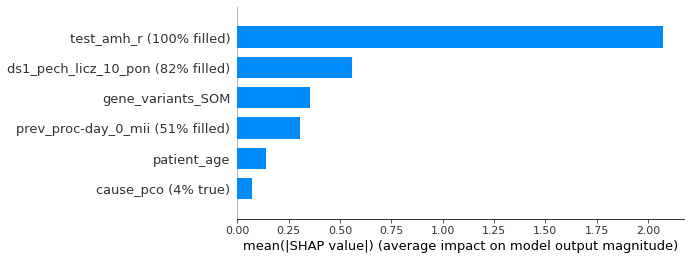

In [16]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    #"prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    'gene_variants_SOM']
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

# Summary of features - correlations

       test_amh_r  ds1_pech_licz_10_pon  patient_age  \
count  711.000000            592.000000   711.000000   
mean     3.187370             15.064189    31.756681   
std      2.629837             10.219384     5.950844   
min      0.020000              0.000000    18.000000   
25%      0.940000              7.000000    27.000000   
50%      2.620000             12.000000    32.000000   
75%      4.445000             22.000000    36.000000   
max      9.950000             50.000000    46.000000   

       prev_proc-cumulus_denuded  gene_variants_MIM  prev_proc-day_0_mii  \
count                 383.000000         711.000000           293.000000   
mean                    9.592689           0.945148             6.225256   
std                     7.288458           0.751394             5.377889   
min                     0.000000           0.000000             0.000000   
25%                     4.000000           0.000000             3.000000   
50%                     8.000000       

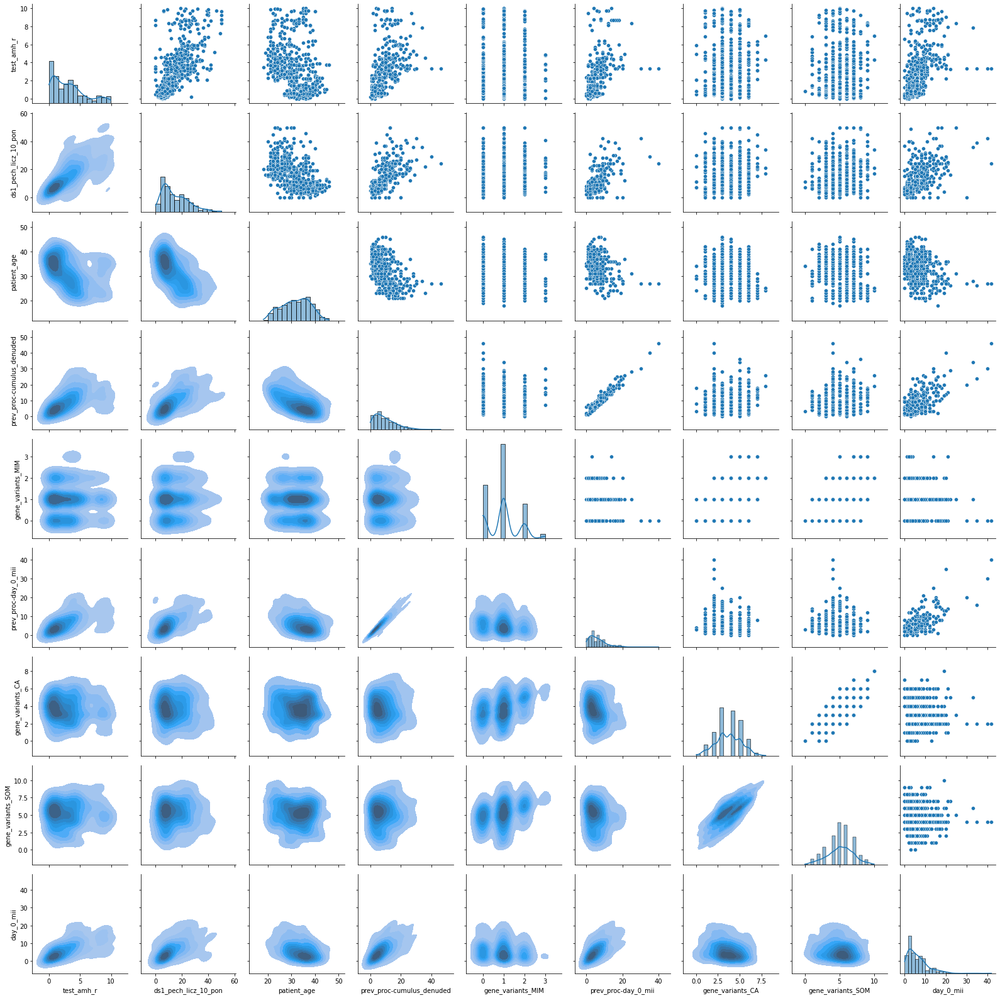

In [8]:
summarize_group(data_900_df[data_900_df['test_amh_r'] < 10.0],
["test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    'gene_variants_MIM',
    "prev_proc-day_0_mii",
    'gene_variants_CA',
    'gene_variants_SOM',
    'day_0_mii'],group='')

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1245: UserWarning:

categorical_column in param dict is overridden.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\lightgbm\basic.py:1433: UserWarning:

Overriding the parameters from Reference Dataset.

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1y

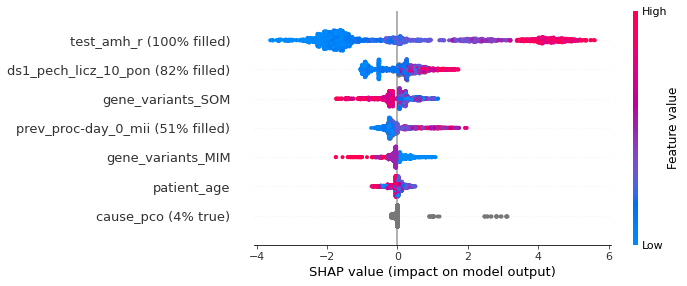

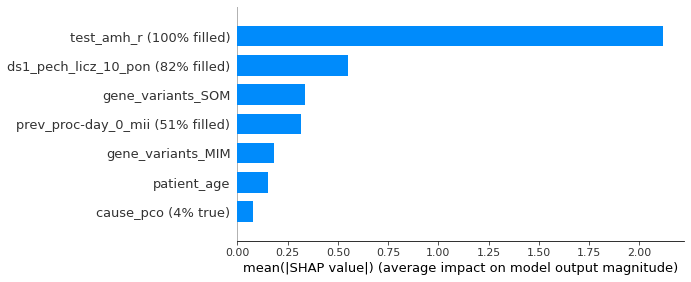

In [18]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    #"prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    'gene_variants_SOM',
    'gene_variants_MIM']
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

# ECDF

C:\Users\zielinskik\AppData\Local\pypoetry\Cache\virtualenvs\3x1-BV1yjxRd-py3.8\lib\site-packages\seaborn\axisgrid.py:392: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



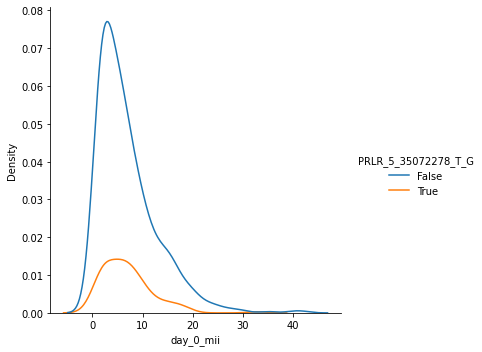

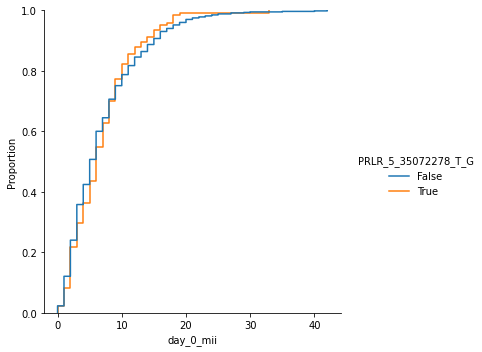

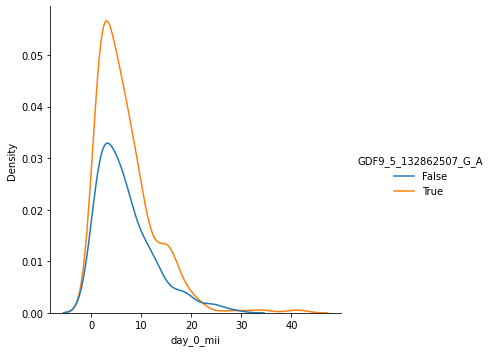

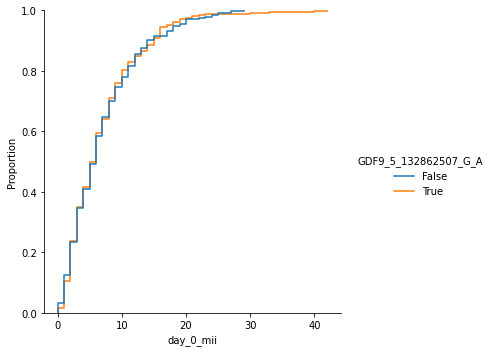

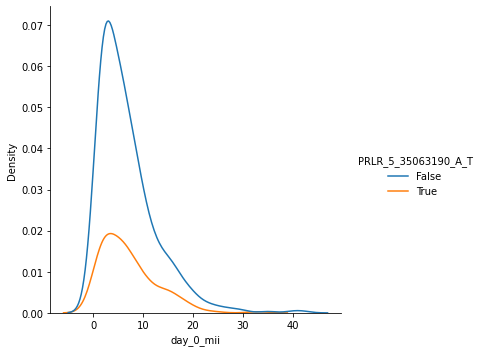

...

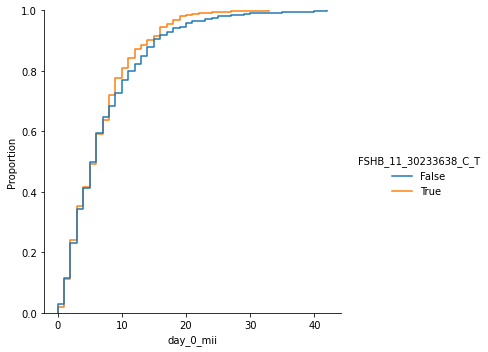

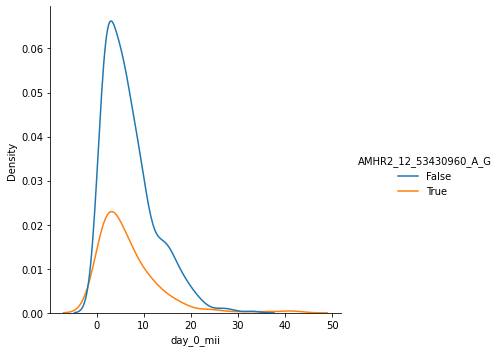

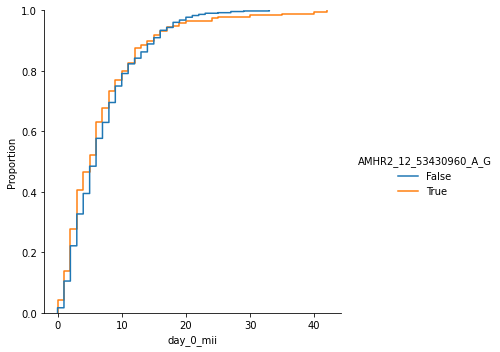

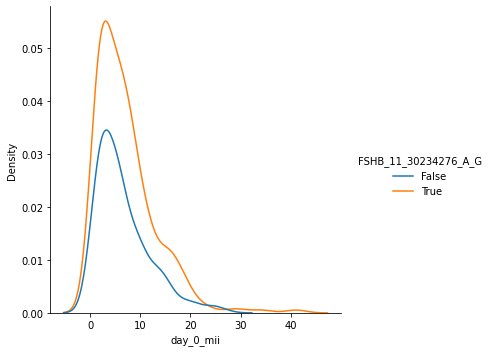

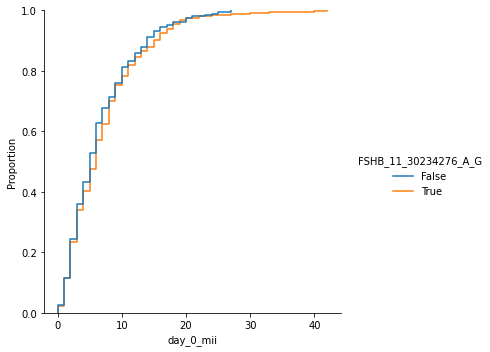

In [23]:
import seaborn as sns
gene_column_list = ranking.sort_values(by='SHAP').loc[:,'Score'].index[:50].copy().to_list()
for gene_column in gene_column_list:
    sns.displot(data_900_df, x="day_0_mii", hue=gene_column, kind="kde")
    sns.displot(data_900_df, x="day_0_mii", hue=gene_column, kind="ecdf")

In [ ]:
gene_column_list

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

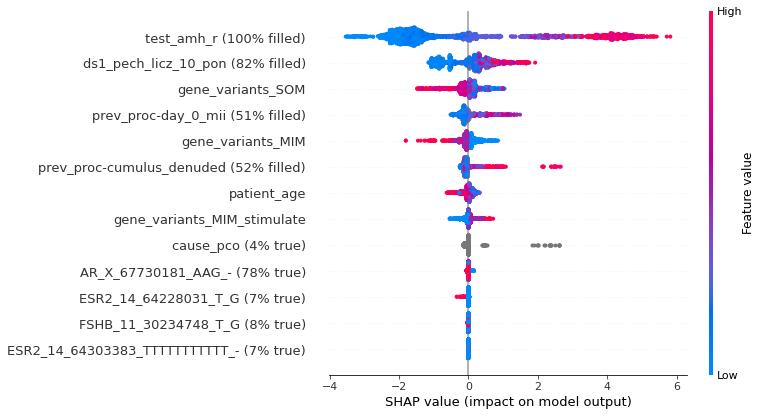

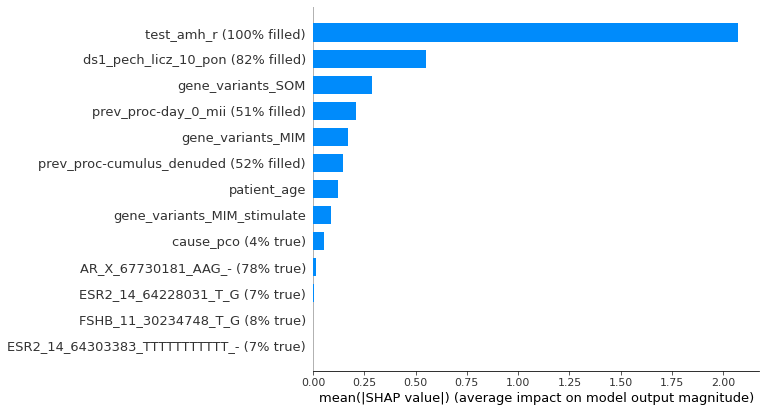

In [16]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    'FSHB_11_30234748_T_G',
    'ESR2_14_64303383_TTTTTTTTTTT_-',
    'ESR2_14_64228031_T_G',
    'AR_X_67730181_AAG_-',
    'gene_variants_SOM',
    'gene_variants_MIM_stimulate',
    'gene_variants_MIM'
    ]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

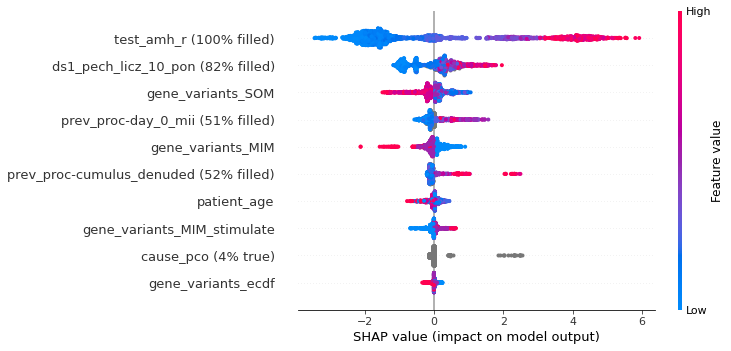

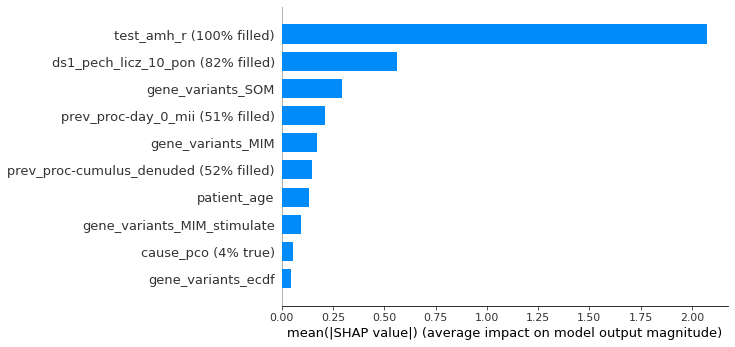

In [5]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    'gene_variants_ecdf',
    'gene_variants_SOM',
    'gene_variants_MIM_stimulate',
    'gene_variants_MIM'
    ]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

In [ ]:
data_900_df.loc[:3,'mii_group']

In [26]:
GENE_RESULTS.train_infos['900_day_0_mii'].avg_errors_info_per_poseidon_group

{'4_old35_lowAMH1.2': ErrorsInfo(count=113, target_avg=2.938053097345133, errors_info={('RMSE', 'l2'): 1.8475916614316692, ('MAE', 'l2'): 1.478687244198544, ('MAPE', 'l2'): 0.727087626494866, ('LIKELIHOOD', 'l2'): 1.4324091505410608}),
 '3_young35_lowAMH1.2': ErrorsInfo(count=83, target_avg=3.2650602409638556, errors_info={('RMSE', 'l2'): 1.9345285467213253, ('MAE', 'l2'): 1.6006921420627247, ('MAPE', 'l2'): 0.6170916535234293, ('LIKELIHOOD', 'l2'): 1.390066741859292}),
 '0b_first_time': ErrorsInfo(count=150, target_avg=7.713333333333333, errors_info={('RMSE', 'l2'): 4.311136060593405, ('MAE', 'l2'): 3.347847755258068, ('MAPE', 'l2'): 0.8108295909080738, ('LIKELIHOOD', 'l2'): 5.885679374673328}),
 '2a_old35_highAMH1.2_prev0to3': ErrorsInfo(count=27, target_avg=4.2592592592592595, errors_info={('RMSE', 'l2'): 3.0309078320583582, ('MAE', 'l2'): 2.6243827153898653, ('MAPE', 'l2'): 1.2081493022842746, ('LIKELIHOOD', 'l2'): 3.0367689382210616}),
 '2b_old35_highAMH1.2_prev4to9': ErrorsInfo(c

In [5]:
data_900_df['group_mii'] = pd.qcut(data_900_df['day_0_mii'],5)


In [21]:
data_900_df.groupby('mii_group').agg(dict(zip(GENE_COL_SETS.ALL_GENES_COLS_900,np.repeat('mean',len(GENE_COL_SETS.ALL_GENES_COLS_900))))).sub(
    data_900_df.agg(dict(zip(GENE_COL_SETS.ALL_GENES_COLS_900,np.repeat('mean',len(GENE_COL_SETS.ALL_GENES_COLS_900)))))
)

,AMHR2_12_53424132_T_A,AMHR2_12_53424433_G_A,AMHR2_12_53425136_C_T,AMHR2_12_53425326_A_G,AMHR2_12_53425683_C_T,AMHR2_12_53428886_G_A,AMHR2_12_53429208_T_C,AMHR2_12_53429253_G_A,AMHR2_12_53429539_C_T,AMHR2_12_53429764_A_G,AMHR2_12_53430187_CTGGGCAATACCCCTACCTCTGATGAG_-,AMHR2_12_53430359_A_G,AMHR2_12_53430960_A_G,AMHR2_12_53431536_T_C,AMHR2_12_53431541_T_C,AMH_19_2249385_C_T,AMH_19_2249408_A_G,AMH_19_2249584_G_A,AMH_19_2249635_G_A,AMH_19_2249737_G_C,AMH_19_2250176_C_T,AMH_19_2250237_G_A,AMH_19_2250313_C_T,AMH_19_2250352_C_T,AMH_19_2250470_G_A,AMH_19_2250477_C_G,AMH_19_2250523_G_A,AMH_19_2250529_G_A,AMH_19_2251138_C_G,AMH_19_2251179_G_A,AMH_19_2251180_G_A,AMH_19_2251248_A_G,AMH_19_2251328_C_T,AMH_19_2251513_T_A,AMH_19_2251806_T_A,AMH_19_2251818_T_C,AMH_19_2251830_C_T,AMH_19_2252009_G_A,AR_X_67544084_C_T,AR_X_67544143_C_T,AR_X_67544564_C_A,AR_X_67544653_T_G,AR_X_67544777_G_A,AR_X_67544940_C_A,AR_X_67545317_GCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545344_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545344_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545356_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545362_GCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545362_GCAGCAGCA_-,AR_X_67545368_GCAGCAGCAGCAGCAGCA_-,AR_X_67545395_C_-,AR_X_67545755_C_G,AR_X_67545785_G_A,AR_X_67546126_G_A,AR_X_67568651_T_C,AR_X_67568721_G_T,AR_X_67568904_T_C,AR_X_67569119_T_-,AR_X_67643001_A_G,AR_X_67643238_T_C,AR_X_67685794_A_-,AR_X_67685838_A_G,AR_X_67686029_C_T,AR_X_67686033_A_G,AR_X_67711195_A_T,AR_X_67711390_C_A,AR_X_67711453_C_A,AR_X_67717774_G_A,AR_X_67721651_A_-,AR_X_67721755_T_G,AR_X_67721909_C_G,AR_X_67722628_G_A,AR_X_67722634_A_G,AR_X_67722783_G_A,AR_X_67722994_C_T,AR_X_67723424_G_C,AR_X_67723521_-_ACACAC,AR_X_67723521_-_CACACAC,AR_X_67723521_-_CACACACAC,AR_X_67723521_AC_-,AR_X_67723869_C_G,AR_X_67723988_T_C,AR_X_67724000_T_-,AR_X_67724278_A_-,AR_X_67724735_CTCA_-,AR_X_67725014_ACTAC_TT,AR_X_67725256_G_A,AR_X_67725522_A_C,AR_X_67725572_G_T,AR_X_67725898_T_C,AR_X_67726738_T_-,AR_X_67726853_G_C,AR_X_67727009_T_C,AR_X_67727012_G_A,AR_X_67727062_A_C,AR_X_67727178_T_A,AR_X_67727213_T_A,AR_X_67727218_A_C,AR_X_67727264_T_A,AR_X_67727270_A_-,AR_X_67727302_T_C,AR_X_67728178_-_T,AR_X_67729703_C_T,AR_X_67729880_C_T,AR_X_67729979_-_A,AR_X_67729999_T_A,AR_X_67730000_-_A,AR_X_67730174_AAGAAAT_-,AR_X_67730177_AAATAAG_TAAT,AR_X_67730179_ATAAGAAG_-,AR_X_67730181_AAG_-,AR_X_67730263_C_T,BMP15_X_50910977_A_G,BMP15_X_50912132_A_-,BMP15_X_50915683_A_C,BMP15_X_50915760_C_T,BMP15_X_50915966_G_A,BMP15_X_50916009_T_C,BMP15_X_50916102_-_C,BMP15_X_50916212_-_CTT,BMP15_X_50916280_C_T,BMP15_X_50916416_G_A,BMP15_X_50916439_C_T,BMP15_X_50916468_TG_-,ESR1_6_151690693_T_-,ESR1_6_151701629_T_C,ESR1_6_151701669_C_T,ESR1_6_151702056_G_A,ESR1_6_151805650_C_G,ESR1_6_151805689_T_G,ESR1_6_151805796_G_T,ESR1_6_151805798_A_G,ESR1_6_151806491_C_T,ESR1_6_151806531_-_TA,ESR1_6_151806531_TATATATATATATATA_-,ESR1_6_151806531_TATATATATA_-,ESR1_6_151806531_TATATATA_-,ESR1_6_151806531_TATATA_-,ESR1_6_151806531_TATA_-,ESR1_6_151806532_A_G,ESR1_6_151806547_TATATATATAT_C,ESR1_6_151806555_TATACA_CAT,ESR1_6_151806559_C_T,ESR1_6_151806573_T_G,ESR1_6_151807059_C_T,ESR1_6_151807128_C_T,ESR1_6_151807496_C_G,ESR1_6_151807507_A_G,ESR1_6_151807717_G_A,ESR1_6_151807928_C_T,ESR1_6_151807942_T_C,ESR1_6_151808169_C_T,ESR1_6_151808173_G_-,ESR1_6_151808173_G_C,ESR1_6_151808264_T_C,ESR1_6_151808332_G_T,ESR1_6_151808407_G_C,ESR1_6_151808453_C_T,ESR1_6_151808466_G_T,ESR1_6_151842084_G_A,ESR1_6_151842149_A_G,ESR1_6_151842151_A_C,ESR1_6_151842200_T_-,ESR1_6_151842521_G_A,ESR1_6_151842622_G_T,ESR1_6_151842832_A_G,ESR1_6_151842891_A_G,ESR1_6_151880740_T_C,ESR1_6_151880872_T_C,ESR1_6_151944034_G_A,ESR1_6_151944148_-_T,ESR1_6_151944148_-_TT,ESR1_6_151944217_C_T,ESR1_6_151944218_G_A,ESR1_6_151944308_A_G,ESR1_6_151944387_G_C,ESR1_6_151944524_G_A,ESR1_6_152011383_A_G,ESR1_6_152011519_T_C,ESR1_6_152011609_G_A,ESR1_6_152011874_T_A,ESR1_6_152011897_A_G,ESR1_6_152060863_T_C,ESR1_6_152060879_A_G,ESR1_6_152060953_-_T,ESR1_6_152061176_G_T,ESR1_6_152

In [20]:
data_900_df.groupby('mii_group').agg(dict(zip(GENE_COL_SETS.ALL_GENES_COLS_900,np.repeat('sum',len(GENE_COL_SETS.ALL_GENES_COLS_900)))))

,AMHR2_12_53424132_T_A,AMHR2_12_53424433_G_A,AMHR2_12_53425136_C_T,AMHR2_12_53425326_A_G,AMHR2_12_53425683_C_T,AMHR2_12_53428886_G_A,AMHR2_12_53429208_T_C,AMHR2_12_53429253_G_A,AMHR2_12_53429539_C_T,AMHR2_12_53429764_A_G,AMHR2_12_53430187_CTGGGCAATACCCCTACCTCTGATGAG_-,AMHR2_12_53430359_A_G,AMHR2_12_53430960_A_G,AMHR2_12_53431536_T_C,AMHR2_12_53431541_T_C,AMH_19_2249385_C_T,AMH_19_2249408_A_G,AMH_19_2249584_G_A,AMH_19_2249635_G_A,AMH_19_2249737_G_C,AMH_19_2250176_C_T,AMH_19_2250237_G_A,AMH_19_2250313_C_T,AMH_19_2250352_C_T,AMH_19_2250470_G_A,AMH_19_2250477_C_G,AMH_19_2250523_G_A,AMH_19_2250529_G_A,AMH_19_2251138_C_G,AMH_19_2251179_G_A,AMH_19_2251180_G_A,AMH_19_2251248_A_G,AMH_19_2251328_C_T,AMH_19_2251513_T_A,AMH_19_2251806_T_A,AMH_19_2251818_T_C,AMH_19_2251830_C_T,AMH_19_2252009_G_A,AR_X_67544084_C_T,AR_X_67544143_C_T,AR_X_67544564_C_A,AR_X_67544653_T_G,AR_X_67544777_G_A,AR_X_67544940_C_A,AR_X_67545317_GCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545344_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545344_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545356_GCAGCAGCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545362_GCAGCAGCAGCAGCAGCAGCAGCA_-,AR_X_67545362_GCAGCAGCA_-,AR_X_67545368_GCAGCAGCAGCAGCAGCA_-,AR_X_67545395_C_-,AR_X_67545755_C_G,AR_X_67545785_G_A,AR_X_67546126_G_A,AR_X_67568651_T_C,AR_X_67568721_G_T,AR_X_67568904_T_C,AR_X_67569119_T_-,AR_X_67643001_A_G,AR_X_67643238_T_C,AR_X_67685794_A_-,AR_X_67685838_A_G,AR_X_67686029_C_T,AR_X_67686033_A_G,AR_X_67711195_A_T,AR_X_67711390_C_A,AR_X_67711453_C_A,AR_X_67717774_G_A,AR_X_67721651_A_-,AR_X_67721755_T_G,AR_X_67721909_C_G,AR_X_67722628_G_A,AR_X_67722634_A_G,AR_X_67722783_G_A,AR_X_67722994_C_T,AR_X_67723424_G_C,AR_X_67723521_-_ACACAC,AR_X_67723521_-_CACACAC,AR_X_67723521_-_CACACACAC,AR_X_67723521_AC_-,AR_X_67723869_C_G,AR_X_67723988_T_C,AR_X_67724000_T_-,AR_X_67724278_A_-,AR_X_67724735_CTCA_-,AR_X_67725014_ACTAC_TT,AR_X_67725256_G_A,AR_X_67725522_A_C,AR_X_67725572_G_T,AR_X_67725898_T_C,AR_X_67726738_T_-,AR_X_67726853_G_C,AR_X_67727009_T_C,AR_X_67727012_G_A,AR_X_67727062_A_C,AR_X_67727178_T_A,AR_X_67727213_T_A,AR_X_67727218_A_C,AR_X_67727264_T_A,AR_X_67727270_A_-,AR_X_67727302_T_C,AR_X_67728178_-_T,AR_X_67729703_C_T,AR_X_67729880_C_T,AR_X_67729979_-_A,AR_X_67729999_T_A,AR_X_67730000_-_A,AR_X_67730174_AAGAAAT_-,AR_X_67730177_AAATAAG_TAAT,AR_X_67730179_ATAAGAAG_-,AR_X_67730181_AAG_-,AR_X_67730263_C_T,BMP15_X_50910977_A_G,BMP15_X_50912132_A_-,BMP15_X_50915683_A_C,BMP15_X_50915760_C_T,BMP15_X_50915966_G_A,BMP15_X_50916009_T_C,BMP15_X_50916102_-_C,BMP15_X_50916212_-_CTT,BMP15_X_50916280_C_T,BMP15_X_50916416_G_A,BMP15_X_50916439_C_T,BMP15_X_50916468_TG_-,ESR1_6_151690693_T_-,ESR1_6_151701629_T_C,ESR1_6_151701669_C_T,ESR1_6_151702056_G_A,ESR1_6_151805650_C_G,ESR1_6_151805689_T_G,ESR1_6_151805796_G_T,ESR1_6_151805798_A_G,ESR1_6_151806491_C_T,ESR1_6_151806531_-_TA,ESR1_6_151806531_TATATATATATATATA_-,ESR1_6_151806531_TATATATATA_-,ESR1_6_151806531_TATATATA_-,ESR1_6_151806531_TATATA_-,ESR1_6_151806531_TATA_-,ESR1_6_151806532_A_G,ESR1_6_151806547_TATATATATAT_C,ESR1_6_151806555_TATACA_CAT,ESR1_6_151806559_C_T,ESR1_6_151806573_T_G,ESR1_6_151807059_C_T,ESR1_6_151807128_C_T,ESR1_6_151807496_C_G,ESR1_6_151807507_A_G,ESR1_6_151807717_G_A,ESR1_6_151807928_C_T,ESR1_6_151807942_T_C,ESR1_6_151808169_C_T,ESR1_6_151808173_G_-,ESR1_6_151808173_G_C,ESR1_6_151808264_T_C,ESR1_6_151808332_G_T,ESR1_6_151808407_G_C,ESR1_6_151808453_C_T,ESR1_6_151808466_G_T,ESR1_6_151842084_G_A,ESR1_6_151842149_A_G,ESR1_6_151842151_A_C,ESR1_6_151842200_T_-,ESR1_6_151842521_G_A,ESR1_6_151842622_G_T,ESR1_6_151842832_A_G,ESR1_6_151842891_A_G,ESR1_6_151880740_T_C,ESR1_6_151880872_T_C,ESR1_6_151944034_G_A,ESR1_6_151944148_-_T,ESR1_6_151944148_-_TT,ESR1_6_151944217_C_T,ESR1_6_151944218_G_A,ESR1_6_151944308_A_G,ESR1_6_151944387_G_C,ESR1_6_151944524_G_A,ESR1_6_152011383_A_G,ESR1_6_152011519_T_C,ESR1_6_152011609_G_A,ESR1_6_152011874_T_A,ESR1_6_152011897_A_G,ESR1_6_152060863_T_C,ESR1_6_152060879_A_G,ESR1_6_152060953_-_T,ESR1_6_152061176_G_T,ESR1_6_152

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

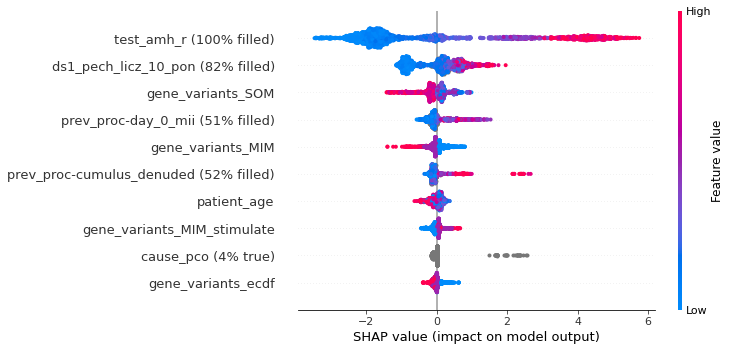

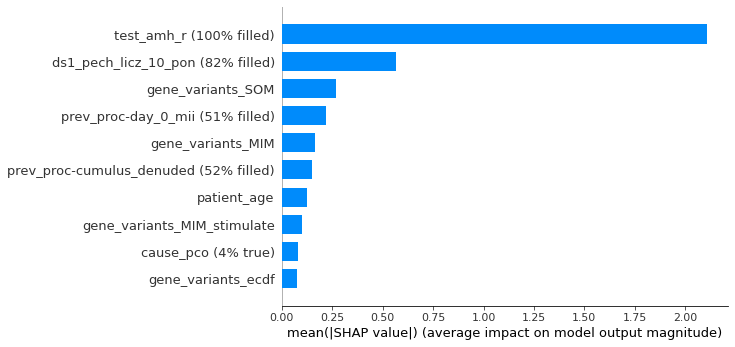

In [5]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    'gene_variants_ecdf',
    'gene_variants_SOM',
    'gene_variants_MIM_stimulate',
    'gene_variants_MIM'
    ]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

In [6]:
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()

In [12]:
GENE_RESULTS_df['error'] = GENE_RESULTS_df['day_0_mii']-GENE_RESULTS_df['prediction_l2']

<AxesSubplot:xlabel='day_0_mii', ylabel='error'>

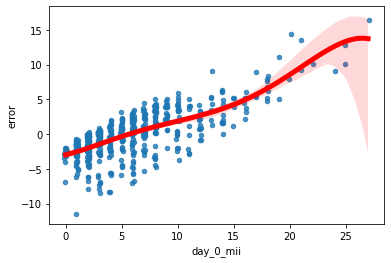

In [13]:
sns.regplot(
    y="error", 
    x="day_0_mii",    
    data=GENE_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

<AxesSubplot:xlabel='error', ylabel='Count'>

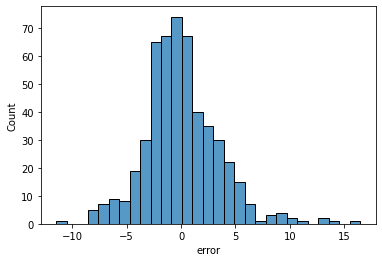

In [15]:
sns.histplot(
    data=GENE_RESULTS_df,
    x="error"
)

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.


<AxesSubplot:xlabel='day_0_mii', ylabel='error'>

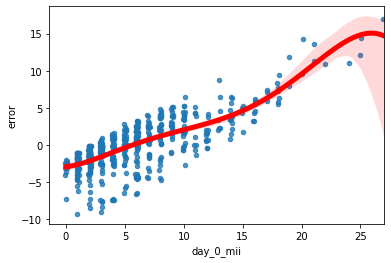

In [14]:
FIRST_VISIT_COLS = [
    "test_amh_r",
    "patient_age",
    "ds1_pech_licz_10_pon",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
]
FIRST_VISIT_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    FIRST_VISIT_COLS,
    model_suffixes_filter=['l2'])
FIRST_VISIT_RESULTS_df = FIRST_VISIT_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
FIRST_VISIT_RESULTS_df['error'] = FIRST_VISIT_RESULTS_df['day_0_mii']-FIRST_VISIT_RESULTS_df['prediction_l2']
sns.regplot(
    y="error", 
    x="day_0_mii",    
    data=FIRST_VISIT_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

# After Outliers removal

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

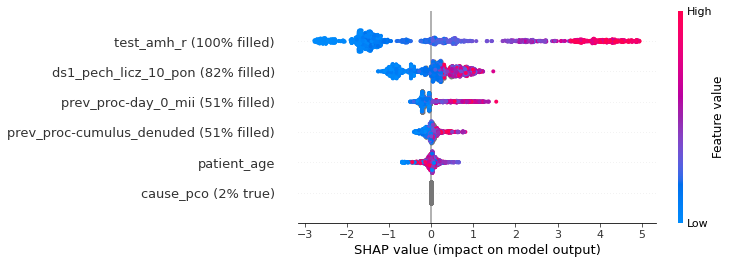

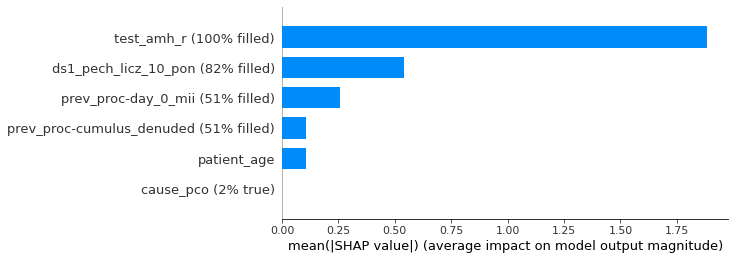

In [5]:
FIRST_VISIT_COLS = [
    "test_amh_r",
    "patient_age",
    "ds1_pech_licz_10_pon",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
]
FIRST_VISIT_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    FIRST_VISIT_COLS,
    model_suffixes_filter=['l2'])
FIRST_VISIT_RESULTS.print_errors(
    [FIRST_VISIT_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    FIRST_VISIT_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))


<AxesSubplot:xlabel='day_0_mii', ylabel='error'>

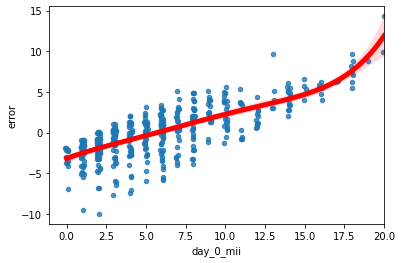

In [6]:
FIRST_VISIT_RESULTS_df = FIRST_VISIT_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
FIRST_VISIT_RESULTS_df['error'] = FIRST_VISIT_RESULTS_df['day_0_mii']-FIRST_VISIT_RESULTS_df['prediction_l2']
sns.regplot(
    y="error", 
    x="day_0_mii",    
    data=FIRST_VISIT_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

# Error per mii group

<AxesSubplot:xlabel='error', ylabel='Count'>

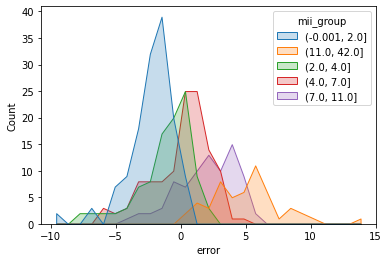

In [7]:
sns.histplot(FIRST_VISIT_RESULTS_df, x="error", hue="mii_group", element="poly")

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
-
RMSE[fold_avg][l2]

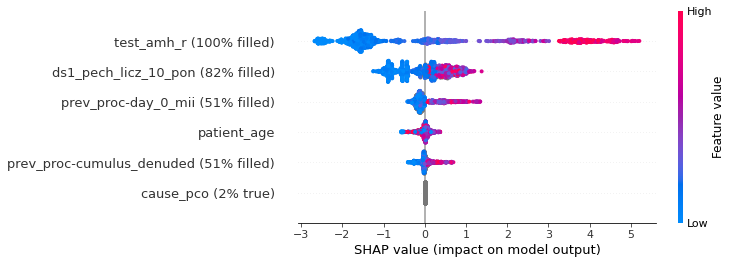

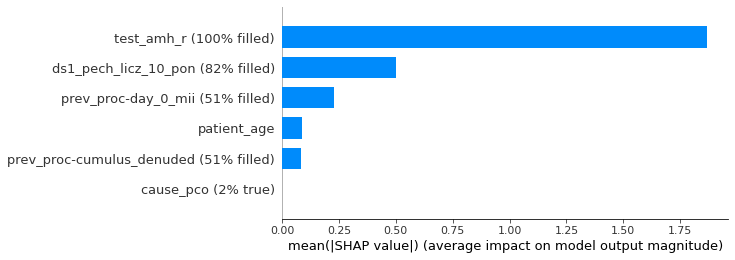

In [6]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
#    'gene_variants_ecdf',
#    'gene_variants_SOM',
#    'gene_variants_MIM_stimulate',
#    'gene_variants_MIM'
    ]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_900,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='900_day_0_mii',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

<AxesSubplot:xlabel='day_0_mii', ylabel='error'>

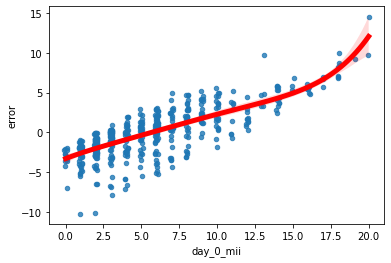

In [7]:
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('900_day_0_mii').copy()
GENE_RESULTS_df['error'] = GENE_RESULTS_df['day_0_mii']-GENE_RESULTS_df['prediction_l2']
sns.regplot(
    y="error", 
    x="day_0_mii",    
    data=GENE_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

<AxesSubplot:xlabel='error', ylabel='Count'>

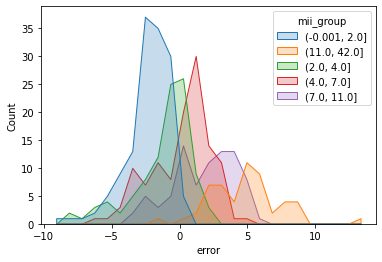

In [11]:
sns.histplot(GENE_RESULTS_df, x="error", hue="mii_group", element="poly")

In [12]:
GENE_RESULTS_df.groupby('mii_group').agg({'error':'median'})

,error
mii_group,
"(-0.001, 2.0]",-2.052627
"(11.0, 42.0]",5.140892
"(2.0, 4.0]",-0.603868
"(4.0, 7.0]",0.681095
"(7.0, 11.0]",2.159332


In [13]:
FIRST_VISIT_RESULTS_df.groupby('mii_group').agg({'error':'median'})

,error
mii_group,
"(-0.001, 2.0]",-1.937149
"(11.0, 42.0]",5.054042
"(2.0, 4.0]",-0.671529
"(4.0, 7.0]",0.350408
"(7.0, 11.0]",1.999878


In [14]:
GENE_RESULTS_df.groupby('mii_group').agg({'error':'mean'})

,error
mii_group,
"(-0.001, 2.0]",-2.295637
"(11.0, 42.0]",4.811453
"(2.0, 4.0]",-1.193226
"(4.0, 7.0]",0.090583
"(7.0, 11.0]",1.714658


In [15]:
FIRST_VISIT_RESULTS_df.groupby('mii_group').agg({'error':'mean'})

,error
mii_group,
"(-0.001, 2.0]",-2.307492
"(11.0, 42.0]",4.963516
"(2.0, 4.0]",-1.152905
"(4.0, 7.0]",0.008659
"(7.0, 11.0]",1.966563


# Modelling pech licz

Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the parameters from Reference Dataset.
categorical_column in param dict is overridden.
Overriding the param

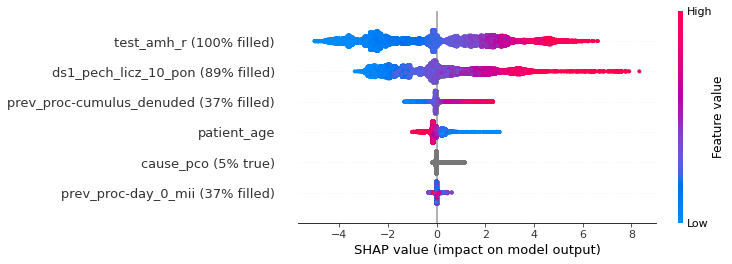

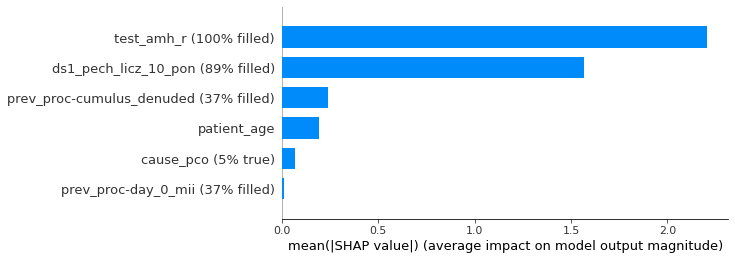

In [6]:
GENE_ADD_COLS = [
    "test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    "prev_proc-day_0_mii",
    "cause_pco",
    ]
GENE_RESULTS = train_data_series(
    LGB_PARAMS_BASE,
    DATA_SERIES_2015,
    GENE_ADD_COLS,
    model_suffixes_filter=['l2'])
GENE_RESULTS.print_errors(
    [GENE_RESULTS],
    print_suffixes=['l2'],
    print_avg=True,
)
explain_model(
    GENE_RESULTS,
    data_serie_name='2015_dslast_pech_licz',
    model_suffix='l2',
    folds=range(0, N_FOLDS))

In [7]:
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('2015_dslast_pech_licz').copy()

In [9]:
prediction_l2_class = pd.cut(GENE_RESULTS_df['prediction_l2'], bins = [0,6,15,1000] ,
        labels=["1", "2","3"], ordered=False)

In [8]:
dslast_pech_licz_class = pd.cut(GENE_RESULTS_df['dslast_pech_licz'], bins = [0,6,15,1000] ,
        labels=["1", "2","3"], ordered=False)

In [10]:
c = confusion_matrix(dslast_pech_licz_class, prediction_l2_class)
df_cm = pd.DataFrame(c)

<AxesSubplot:>

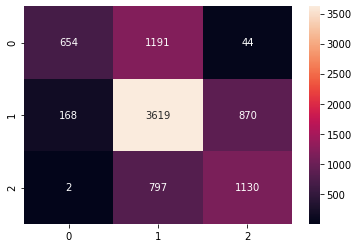

In [11]:
sns.heatmap(c, annot=True, fmt='g')

In [12]:
print('Accuracy = '+ str(accuracy_score(dslast_pech_licz_class, prediction_l2_class)))

Accuracy = 0.6375221238938054


<AxesSubplot:xlabel='dslast_pech_licz', ylabel='error'>

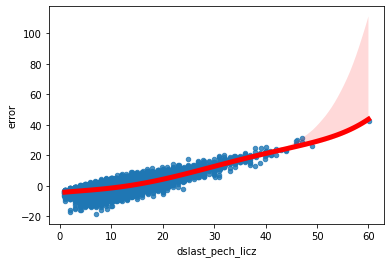

In [8]:
GENE_RESULTS_df['error'] = GENE_RESULTS_df['dslast_pech_licz']-GENE_RESULTS_df['prediction_l2']
sns.regplot(
    y="error", 
    x="dslast_pech_licz",    
    data=GENE_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

In [7]:
GENE_RESULTS_df = GENE_RESULTS.get_merged_test_dfs_from_folds('2015_day_0_mii').copy()

<AxesSubplot:xlabel='day_0_mii', ylabel='error'>

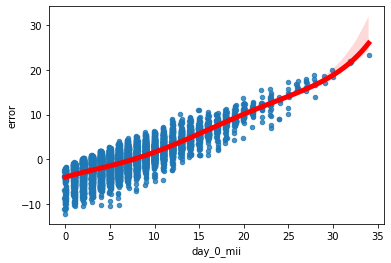

In [8]:
GENE_RESULTS_df['error'] = GENE_RESULTS_df['day_0_mii']-GENE_RESULTS_df['prediction_l2']
sns.regplot(
    y="error", 
    x="day_0_mii",    
    data=GENE_RESULTS_df,
    x_jitter=.1,
    ci = 95,
    scatter_kws={"s": 20},
    line_kws={'lw':5,
    'color':'red'},
    order=5)

<AxesSubplot:xlabel='ds1_dawka_Gonadotropiny', ylabel='Count'>

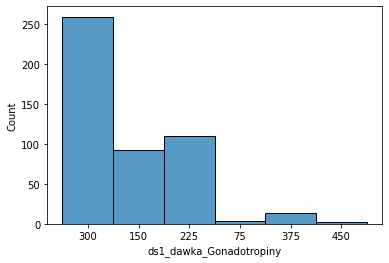

In [7]:
sns.histplot(x=DATA_SERIES_900['900_day_0_mii'].input_df['ds1_dawka_Gonadotropiny'])

<AxesSubplot:xlabel='dslast_pech_licz', ylabel='Count'>

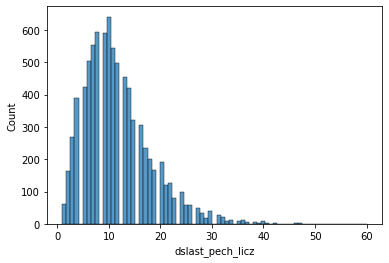

In [6]:
sns.histplot(x=DATA_SERIES_2015['2015_day_0_mii'].input_df['dslast_pech_licz'])

In [9]:
most_difficult_patients = GENE_RESULTS_df.loc[abs(GENE_RESULTS_df['error']/(0.01+GENE_RESULTS_df['day_0_mii']))>1.5].copy()

In [8]:
GENE_RESULTS_df.loc[abs(GENE_RESULTS_df['error']/(0.01+GENE_RESULTS_df['day_0_mii']))>1.5].to_csv('highest_errors.csv',sep=';',encoding='utf-16')

In [10]:
most_difficult_patients.shape

(74, 1622)

       test_amh_r  ds1_pech_licz_10_pon  patient_age  \
count   68.000000             57.000000    68.000000   
mean     2.273529              9.894737    35.838235   
std      2.992478              8.692534     4.159543   
min      0.140000              0.000000    25.000000   
25%      0.527500              5.000000    34.000000   
50%      1.085000              7.000000    36.000000   
75%      2.297500             10.000000    38.250000   
max     13.580000             40.000000    44.000000   

       prev_proc-cumulus_denuded  gene_variants_MIM  prev_proc-day_0_mii  \
count                  38.000000          68.000000            38.000000   
mean                    4.710526           0.632353             3.815789   
std                     3.889750           0.515561             3.270303   
min                     1.000000           0.000000             0.000000   
25%                     2.000000           0.000000             2.000000   
50%                     4.000000       

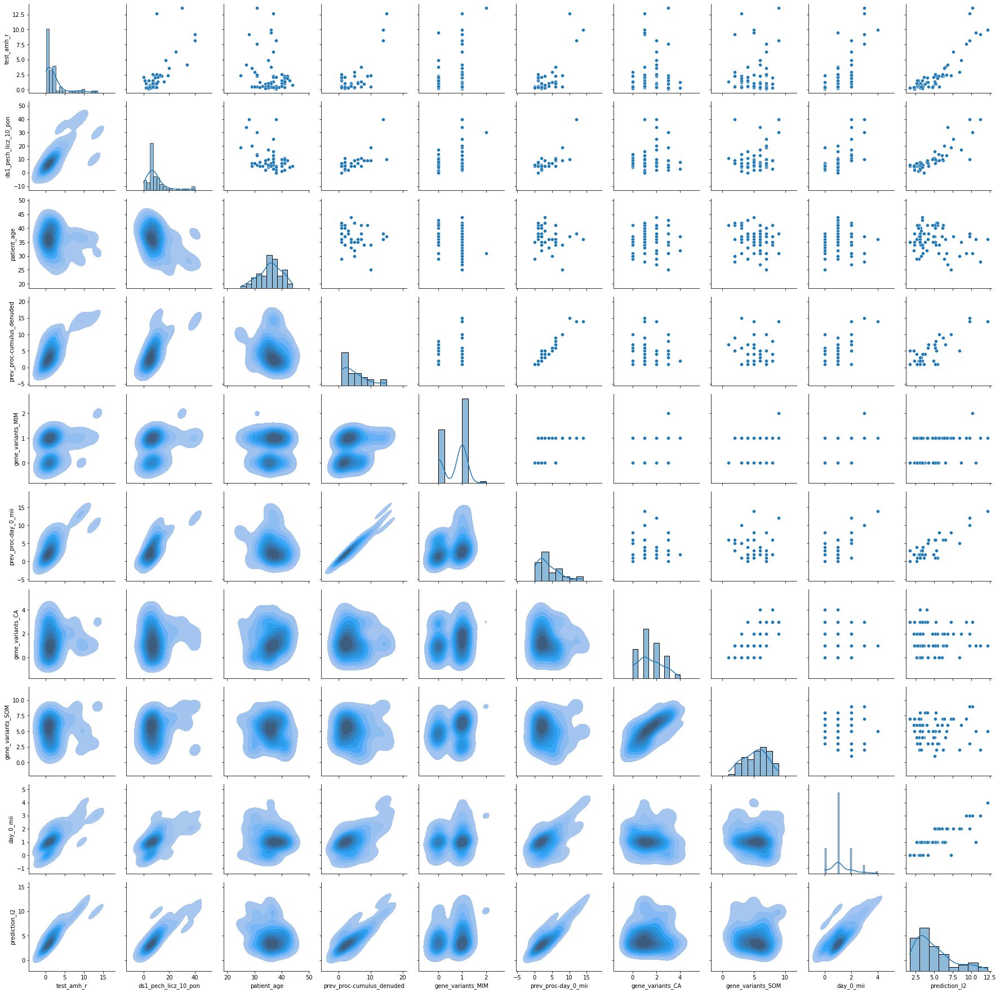

In [31]:
summarize_group(most_difficult_patients,
["test_amh_r",
    "ds1_pech_licz_10_pon",
    "patient_age",
    "prev_proc-cumulus_denuded",
    'gene_variants_MIM',
    "prev_proc-day_0_mii",
    'gene_variants_CA',
    'gene_variants_SOM',
    'day_0_mii',
    'prediction_l2'],group='')

<AxesSubplot:xlabel='day_0_mii', ylabel='test_amh_r'>

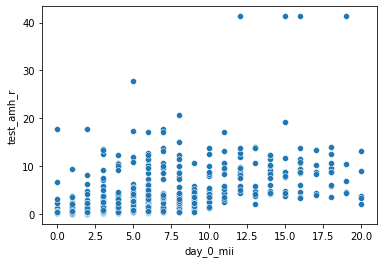

In [16]:
sns.scatterplot(data = data_900_df, x='day_0_mii',y='test_amh_r')